# Flood area segmentation using DeepLabV3 with Cartagena flood images

We are training a model using DeepLabV3 architecture to identify potential flooding sources in the city of Cartagena, Colombia

*   The task is to create a segmentation model, which can accurately segment out the water region in a given picture of a flood hit area, specially identifying Cartagena's most unique features.

### Use case

* This models can be used to prevent and identify the flood areas in the city, which can cause problems in areas such as mobility, health, etc.

### Data distribution

The data is distributed in 2 folders, which are inside the semantic_segmentation/inundaciones path :
* image: contains the dataset images.
* mask: contains the binary masks with  the delimitided flood areas.
* **metadata.csv**: A csv file mapping the image name with its mask.

### Approach

1. Data Loading
  * The first step is to load images with their respective masks.
2. Data Visualization
  * In this step we will visualise the images with their respective masks so that we can better understand the flood problem.
3. DeepLabV3
  * From here we will shift our focus from data model building. As this is an image segmentation task. We have chosen DeepLabV3 model, we will create, train, optimize and evaluate this model.
4. Predictions
  * At last we will visualize the prediction made by the model

### Imports


Here are the imports and libraries we use in this notebook:

In [1]:
from IPython.display import clear_output as cls

!pip install tf_explain

# For formatting
cls()

In [2]:
# Common
import os
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras

# Data
from tqdm import tqdm
from glob import glob
import tensorflow.image as tfi
from tensorflow.keras.utils import load_img, img_to_array

# Data Visulization
import matplotlib.pyplot as plt

# Model Layers
from keras.models import Model
from keras.layers import Layer
from keras.layers import Input
from keras.layers import Conv2D
from keras.layers import Concatenate
from keras.layers import UpSampling2D
from keras.layers import AveragePooling2D
from keras.layers import BatchNormalization
from keras.layers import LeakyReLU, ReLU
from keras.models import Sequential

# Backbone
from tensorflow.keras.applications import ResNet50

# Model Architecture Visualization
from tensorflow.keras.utils import plot_model

# Optimizer
from tensorflow.keras.optimizers import Adam

# Callbacks
from keras.callbacks import ModelCheckpoint, Callback

# Model Layer Visualization
from tf_explain.core.grad_cam import GradCAM

### Data loading

In order to work on the model, first we need to load our data.

In [3]:
import sys
PATH = os.getcwd()
DIR_DATA = PATH + '{0}semantic_segmentation_data'.format(os.sep)
sys.path.append(PATH) if PATH not in list(sys.path) else None
print(f"Current working directory: {PATH}")
# Specify paths
root_path = DIR_DATA
print(f"Root path: {root_path}")
image_path = DIR_DATA + '{0}Image'.format(os.sep)
print(f"Image route: {image_path}")
mask_path = DIR_DATA + '{0}Mask'.format(os.sep)
print(f"Mask route: {mask_path}")
metadata_path = DIR_DATA + '{0}metadata.csv'.format(os.sep)
print(f"Metadata route: {metadata_path}")

Current working directory: c:\Users\usuario\Documents\DeepFlood
Root path: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data
Image route: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data\Image
Mask route: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data\Mask
Metadata route: c:\Users\usuario\Documents\DeepFlood\semantic_segmentation_data\metadata.csv


Let's see whats inside the metadada.csv:


In [4]:
# Load file
metadata = pd.read_csv(metadata_path)

# Show
metadata

,Image,Mask
0,0.jpg,0.png
1,1.jpg,1.png
2,2.jpg,2.png
3,3.jpg,3.png
4,4.jpg,4.png
5,5.jpg,5.png
6,6.jpg,6.png
7,7.jpg,7.png
8,8.jpg,8.png
9,9.jpg,9.png


This file has the **image file name** and it's respective **mask file name**. Although we can use this **metadata file** for **loading our images and their respective masks**, I have a **better option**. Let's create a function to load the **complete data**.

In [5]:
# This is a helper function
def load_image(path:str, SIZE:tuple = (256, 256), mask:bool = False):

    '''
    This function is responsible for loading and processing the image. The function takes in the path of the
    image to be loaded and then loads the image using OpenCV, perform a resize conversionn and cast the image
    to a 32Bit Float Tensor. At last, the image is normalized to change the pixel range from 0 to 255 to
    0 to 1.

    Inputs :
        path : It represents the file path of he image to be loaded.
        size : The desired size in which the image should be resized, default is set to 256 x 256 pixels.
        mask : If the image to be loaded is then the image is a binary map i.e of shape = (*size, 1)

    Output:
        image : The processed image whose file path was provided.
    '''

    # load Image
    image = load_img(path)

    # Convert to an array
    image = img_to_array(image)

    # Resize the image
    image = tfi.resize(image, SIZE)

    # Convert to Tensor of 32Bit - Float
    image = tf.cast(image, tf.float32)

    # Normalize the image
    image = image/255.

    # Mask
    if mask:
        image = image[:, :, :1]

    # return image
    return image

In [6]:
def load_data(root_path:str=root_path):

    '''
    The function is reponsible for loading all the Images and their respective Masks. It does so by first load the file paths of the Images
    then it applies some changes on the Image paths to convert them to Mask Paths. Before loading the Images and Masks, first a empty space
    is created, where the loaded Images and Masks are stored. As last it returns the array of Images and Masks.

    Input :
        root_path : The path to the main directory where both the images & masks are kept.

    Outputs :
        images : Array of all the images present in the data set.
        masks : Array of all the masks present in the data set.
    '''

    # Load the Image and Mask paths
    image_paths = sorted(glob(root_path + "\\Image\\*.jpg"))
    mask_paths  = [path.replace("Image", "Mask").replace("jpg", "png") for path in image_paths]

    # Create space for loading the images and masks
    images = np.empty(shape=(len(image_paths), 256, 256, 3), dtype=np.float32)
    masks  = np.empty(shape=(len(image_paths), 256, 256, 1), dtype=np.float32)

    # load the images and masks
    for i, (img_path, mask_path) in tqdm(enumerate(zip(image_paths, mask_paths)), desc="Loading"):

        # Load the image
        image = load_image(path = img_path, mask = False)

        # Load the respective mask
        mask  = load_image(path = mask_path, mask = True)

        # Put this into the Space
        images[i] = image
        masks[i]  = mask

    # Return the images and Masks
    return images, masks

Now we can see how it works: 

In [7]:
# Colect All images and masks
all_images, all_masks = load_data(root_path)

Loading: 41it [00:00, 58.25it/s]


We need to split the data in order to evaluate it's performance:

In [8]:
# Split data into Training and Testing
data_len = len(all_images)
print("Total Data Length : ", data_len)

# Training set
train_images, train_masks = all_images[:int(data_len*0.8)], all_masks[:int(data_len*0.8)]

# Testing Set
test_images,  test_masks = all_images[int(data_len*0.8):], all_masks[int(data_len*0.8):]

Total Data Length :  41


### Data visualization

In [9]:
def show_images(images, masks, n_images, SIZE=(15,8)) -> None:

    '''
    This function is responsible for visualising N number of images from the given set of Images and the respective masks.
    It does so by plotting the images and masks using matplotlib.

    Inputs :
        images   : The collection of images.
        masks    : The collection of masks.
        n_images : Total number of images to be plotted.
        SIZE     : Size of each plot.

    '''

    # Plot n Images
    for i in range(n_images):

        # Plotting Configuration
        plt.figure(figsize=SIZE)

        # Select a image Randomly
        id = np.random.randint(len(images))

        # Plot the Image
        plt.subplot(1, 3, 1)
        plt.imshow(images[id])
        plt.title("Image")
        plt.axis('off')

        # Plot the Mask
        plt.subplot(1, 3, 2)
        plt.imshow(masks[id], cmap='gray')
        plt.title("Mask")
        plt.axis('off')

        # Plot the Overlapping Mask
        plt.subplot(1, 3, 3)
        plt.imshow(images[id], cmap='gray')
        plt.imshow(masks[id], cmap='gray', alpha=0.5)
        plt.title("Overlapping Mask")
        plt.axis('off')

        # Shwo a Single Frame : This is done to speed up plotting for large number images
        plt.tight_layout()
        plt.show()

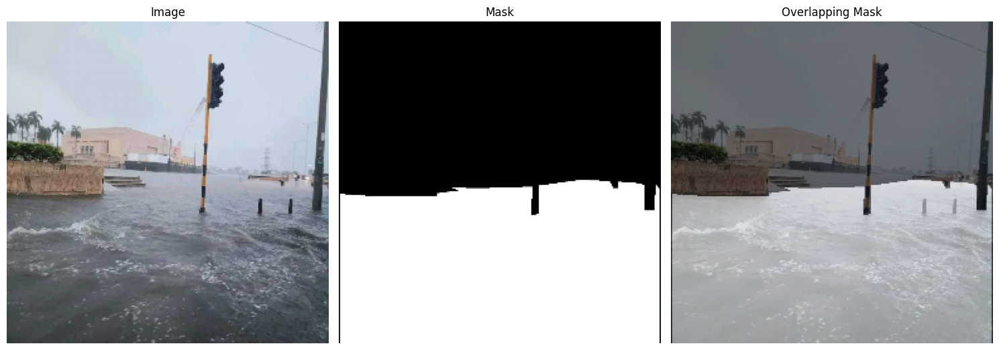

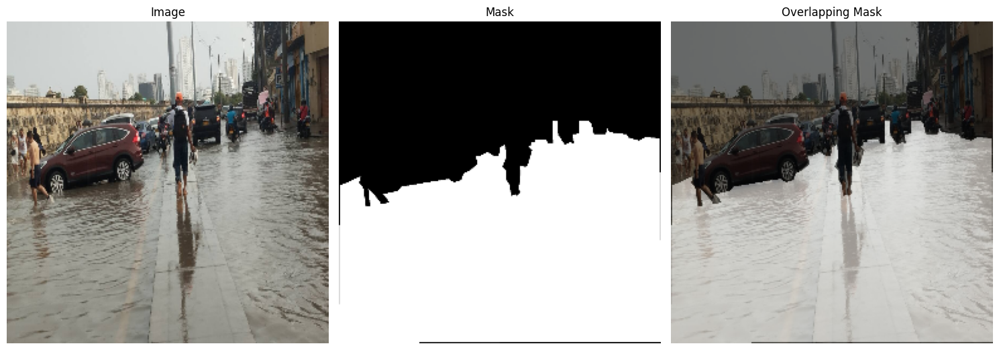

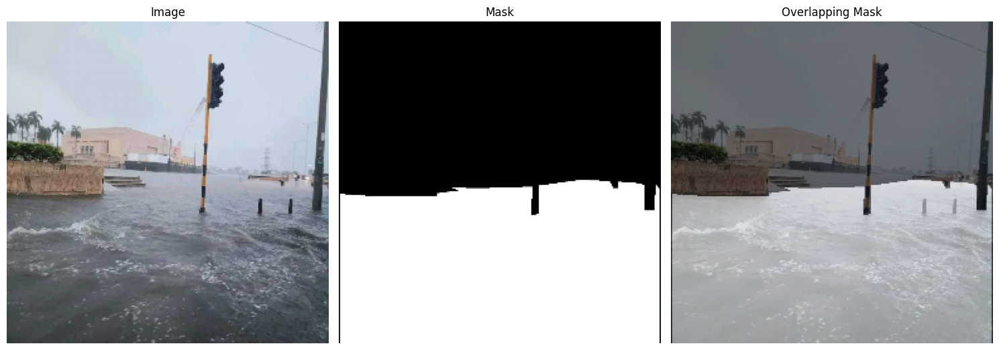

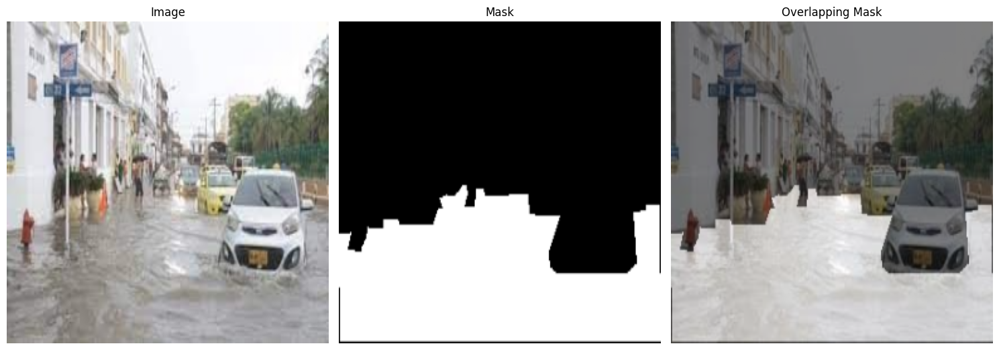

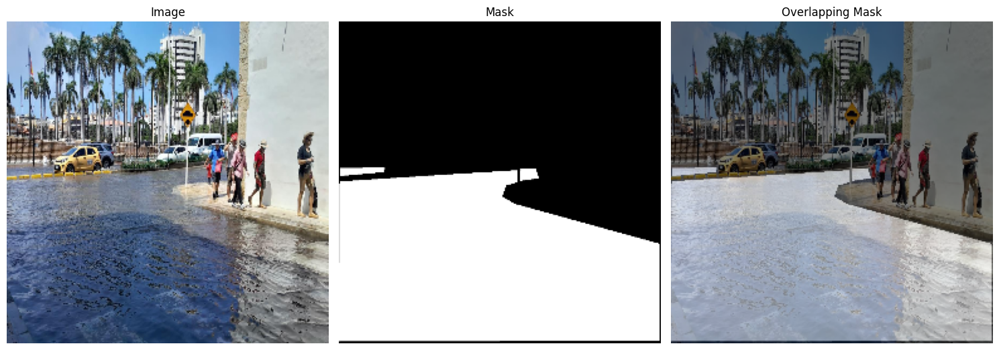

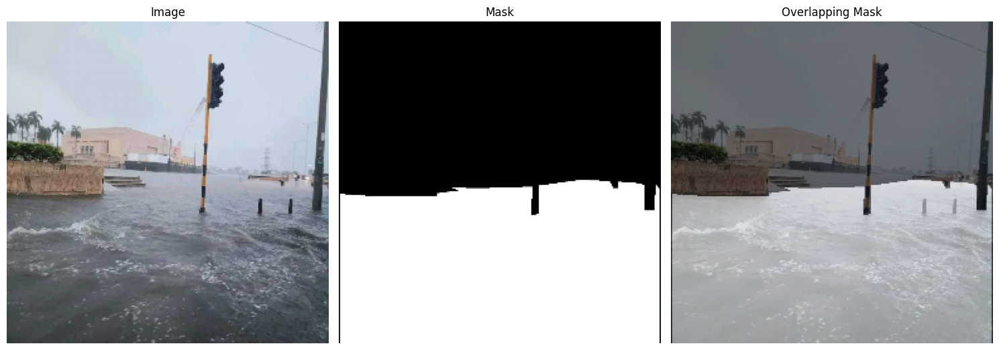

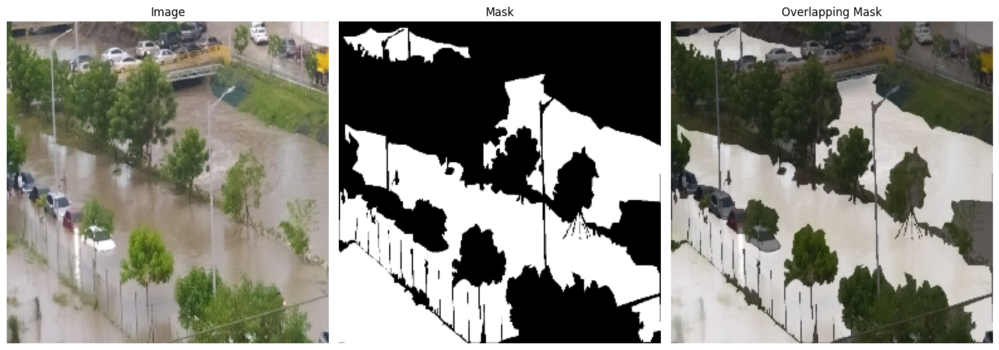

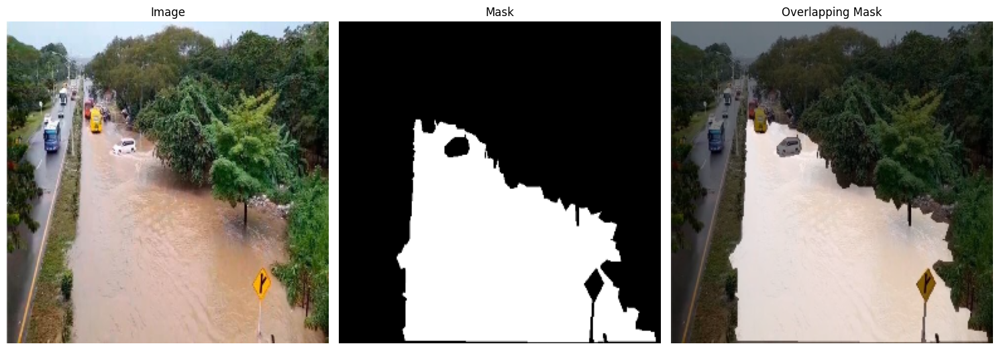

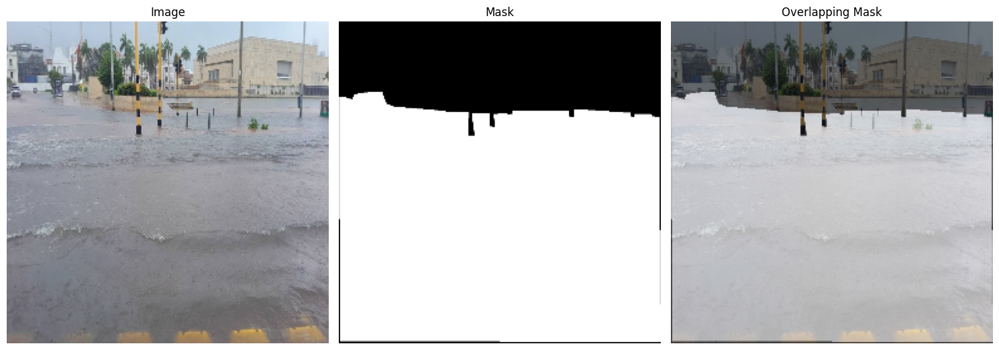

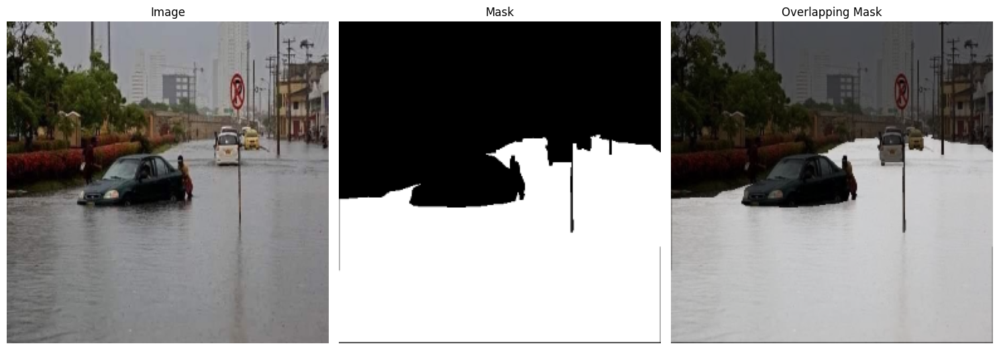

In [10]:
show_images(train_images, train_masks, n_images=10)

# **DeepLabV3+**

In [11]:
class ConvBlock(Layer):

    '''
    As in the Model implementation uses, Conv2D -> BatchNormalization -> ReLU. In the same fashion again and again, that why we have created a Single Layer
    which apply this operation. So ConvBlock = Conv2D -> BatchNormalization -> ReLU. This helps us in implementation.
    '''

    def __init__(self, filters:int = 256, kernel_size:int = 3, dilation_rate:int = 1, **kwargs) -> None:
        super(ConvBlock, self).__init__(**kwargs)

        # Define Parameters
        self.filters = filters
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate

        # Define the model
        self.net = Sequential([
            Conv2D(filters, kernel_size=kernel_size, padding='same', strides=1, dilation_rate=dilation_rate, activation=None, use_bias=False),
            BatchNormalization(),
            ReLU()
        ])

    def call(self, X):
        # Apply the layers
        return self.net(X)

    def get_config(self):
        base_config = super().get_config()

        return {
            **base_config,
            "filters":self.filters,
            "kernel_size":self.kernel_size,
            "dilation_rate":self.dilation_rate
        }

Now we need to define our ASPP module:

In [12]:
def AtrousSpatialPyramidPooling(X):

    # Shape
    _, H, W, C = X.shape

    # Image Pooling
    image_pool = AveragePooling2D(pool_size=(H, W), name="ASPP-ImagePool-AP")(X)
    image_pool = ConvBlock(kernel_size=1, name="ASPP-ImagePool-CB")(image_pool)
    image_pool = UpSampling2D(size=(H//image_pool.shape[1], W//image_pool.shape[1]), name="ASPP-ImagePool-US")(image_pool)

    # Astrous Layers
    conv_1  = ConvBlock(kernel_size=1, dilation_rate=1, name="ASPP-Conv1")(X)
    conv_6  = ConvBlock(kernel_size=3, dilation_rate=6, name="ASPP-Conv6")(X)
    conv_12 = ConvBlock(kernel_size=3, dilation_rate=12, name="ASPP-Conv12")(X)
    conv_18 = ConvBlock(kernel_size=3, dilation_rate=18, name="ASPP-Conv18")(X)

    # Combine All
    combined = Concatenate(name="ASPP-Concatenate")([image_pool, conv_1, conv_6, conv_12, conv_18])
    output = ConvBlock(kernel_size=1, name="ASPP-Out")(combined)

    return output

We have ***sub-layers*** defined, now we need to combine them to create our ***Encoder-Decoder model.***

In [13]:
# Model Specifications
IMAGE_SIZE = 256
MODEL_NAME = "DeepLab-FloodArea"

# Input Layer
inputs = Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3), name="InputLayer")

# Backbone
backbone = ResNet50(input_tensor=inputs, weights='imagenet', include_top=False)

# High Level Features
DCNN = backbone.get_layer('conv4_block6_2_relu').output
ASPP = AtrousSpatialPyramidPooling(DCNN)
ASPP = UpSampling2D(size=(
    IMAGE_SIZE//4//ASPP.shape[1], IMAGE_SIZE//4//ASPP.shape[2]
), name="ASPP-UpSample-Out")(ASPP)

# Low Level Features
LLF = backbone.get_layer('conv2_block3_2_relu').output
LLF = ConvBlock(filters=48, kernel_size=1, name="LLF-ConvBlock")(LLF)

# Combine
concat = Concatenate(axis=-1, name="Concat-LLF-HLF")([LLF, ASPP])
y = ConvBlock(name="TopConvBlock1")(concat)
y = ConvBlock(name="TopConvBlock2")(y)
y = UpSampling2D(size=(
    IMAGE_SIZE//y.shape[1], IMAGE_SIZE//y.shape[2]
), name="Feature-UpSample")(y)

# Output Layer
output = Conv2D(filters=1, kernel_size=3, padding='same', activation='sigmoid', use_bias=False, name="OutputLayer")(y)

# Model
DeepLabV3 = Model(inputs, output, name=MODEL_NAME)

Let's see how is structured our model's architecture:

In [14]:
DeepLabV3.summary()

Model: "DeepLab-FloodArea"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ InputLayer          │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_pad           │ (None, 262, 262,  │          0 │ InputLayer[0][0]  │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, 128, 128,  │      9,472 │ conv1_pad[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, 128, 128,  │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, 128, 128,  │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pad           │ (None, 130, 130,  │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1_pool          │ (None, 64, 64,    │          0 │ pool1_pad[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, 64, 64,    │      4,160 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, 64, 64,    │        256 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, 64, 64,    │          0 │ conv2_block1_1_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, 64, 64,    │     36,928 │ conv2_block1_1_r… │
│ (Conv2D)            │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_bn   │ (None, 64, 64,    │        256 │ conv2_block1_2_c… │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_relu │ (None, 64, 64,    │          0 │ conv2_block1_2_b… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_conv │ (None, 64, 64,    │     16,640 │ pool1_pool[0][0]  │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_conv │ (None, 64, 64,    │     16,640 │ conv2_block1_2_r… │
│ (Conv2D)            │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_0_c… │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_3_bn   │ (None, 64, 64,    │      1,024 │ conv2_block1_3_c

 Total params: 11,854,144 (45.22 MB)

 Trainable params: 11,821,408 (45.10 MB)

 Non-trainable params: 32,736 (127.88 KB)

### DeepLabV3+ Visualization

In [15]:
import os
os.system("dot -V")  # dot es el ejecutable principal de Graphviz

%pip install pydot
%pip install graphviz
import pydot
import graphviz
# Plot the Model
plot_model(DeepLabV3, MODEL_NAME+".png", dpi=96, show_shapes=True)

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


This the model architecture. Now we can focus on the training phase:

### Model Callback

Now it's training time, we could see the progress of this training session throughout some plots of those predictions

In [16]:
def show_model_preds(images, masks, model, SIZE:tuple = (15,8)) -> None:
    # Collect Image and Mask
    id = np.random.randint(len(test_images))
    image, mask = images[id], masks[id]

    # Make Prediction
    pred_mask = model.predict(tf.expand_dims(image, axis=0))

    # Grad CAM
    cam = GradCAM()
    capture = cam.explain(
        validation_data=(tf.expand_dims(image, axis=0).numpy(), mask),
        model=model,
        class_index=1,
        layer_name="TopConvBlock2"
    )

    # Plot Size
    plt.figure(figsize=SIZE)

    # Plot Image
    plt.subplot(1,4,1)
    plt.imshow(image)
    plt.title("Input Image")
    plt.axis('off')

    # Plot Original Mask
    plt.subplot(1,4,2)
    plt.title("Expected Mask")
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    # Plot Predicted Mask
    plt.subplot(1,4,3)
    plt.imshow(tf.squeeze(pred_mask), cmap='gray')
    plt.title("Predicted Mask")
    plt.axis('off')

    # Grad CAM
    plt.subplot(1,4,4)
    plt.title("Grad CAM Visualization")
    plt.imshow(tf.squeeze(capture))
    plt.axis('off')

    # Show the Final Plot
    plt.show()

In [17]:
class ShowProgress(Callback):

    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1)%10==0:
            show_model_preds(test_images, test_masks, self.model)

Epoch 1/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 725ms/step - loss: 0.5444

16/16 ━━━━━━━━━━━━━━━━━━━━ 35s 948ms/step - loss: 0.5397 - val_loss: 1021.4011
Epoch 2/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 734ms/step - loss: 0.2698

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 863ms/step - loss: 0.2711 - val_loss: 115.6520
Epoch 3/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 721ms/step - loss: 0.2707

16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 851ms/step - loss: 0.2692 - val_loss: 77.1830
Epoch 4/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 765ms/step - loss: 0.2282

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 911ms/step - loss: 0.2262 - val_loss: 17.0634
Epoch 5/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 765ms/step - loss: 0.1670

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 909ms/step - loss: 0.1679 - val_loss: 3.3727
Epoch 6/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 762ms/step - loss: 0.1710

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 904ms/step - loss: 0.1725 - val_loss: 1.7236
Epoch 7/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 781ms/step - loss: 0.1572

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 922ms/step - loss: 0.1582 - val_loss: 1.2394
Epoch 8/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 759ms/step - loss: 0.1607

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 891ms/step - loss: 0.1609 - val_loss: 0.6467
Epoch 9/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 723ms/step - loss: 0.1017

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 853ms/step - loss: 0.1033 - val_loss: 0.4663
Epoch 10/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 727ms/step - loss: 0.1239

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


c:\Users\usuario\Documents\DeepFlood\.venv\lib\site-packages\keras\src\models\functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['InputLayer']]
Received: inputs=['Tensor(shape=(1, 256, 256, 3))']
  warnings.warn(msg)


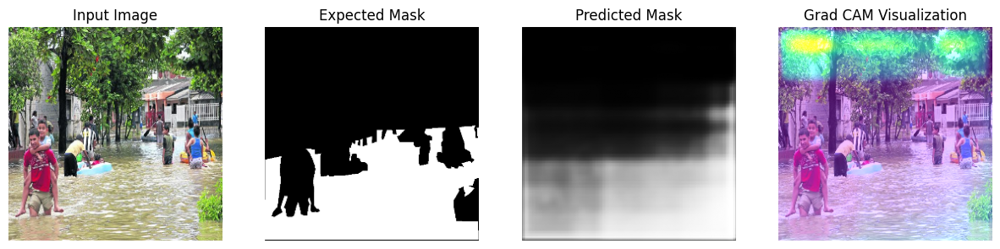

16/16 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - loss: 0.1234 - val_loss: 0.4504
Epoch 11/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 896ms/step - loss: 0.0983 - val_loss: 0.5041
Epoch 12/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 874ms/step - loss: 0.0796 - val_loss: 0.4724
Epoch 13/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 914ms/step - loss: 0.0693 - val_loss: 0.6070
Epoch 14/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 861ms/step - loss: 0.0623 - val_loss: 1.0551
Epoch 15/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 875ms/step - loss: 0.0607 - val_loss: 0.6498
Epoch 16/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 868ms/step - loss: 0.0575 - val_loss: 0.8878
Epoch 17/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 836ms/step - loss: 0.0716 - val_loss: 0.7353
Epoch 18/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 833ms/step - loss: 0.0469 - val_loss: 0.9668
Epoch 19/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 861ms/step - loss: 0.0542 - val_loss: 0.8872
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/stepep - loss: 0.04


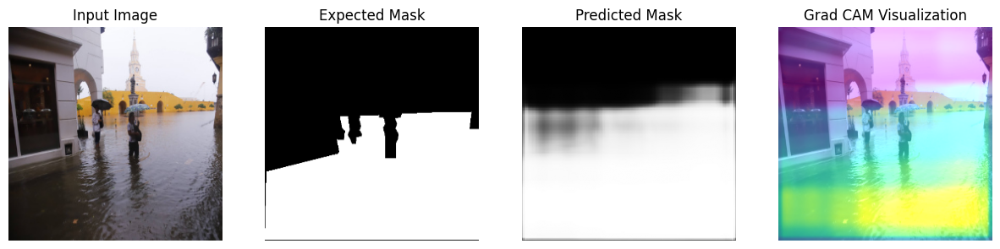

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 934ms/step - loss: 0.0466 - val_loss: 0.8540
Epoch 21/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 821ms/step - loss: 0.0437 - val_loss: 0.9213
Epoch 22/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 807ms/step - loss: 0.0434 - val_loss: 0.6132
Epoch 23/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 807ms/step - loss: 0.0457 - val_loss: 0.6007
Epoch 24/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 809ms/step - loss: 0.0395 - val_loss: 0.5703
Epoch 25/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 800ms/step - loss: 0.0432 - val_loss: 0.5677
Epoch 26/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 819ms/step - loss: 0.0343 - val_loss: 0.5804
Epoch 27/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 840ms/step - loss: 0.0352 - val_loss: 0.6246
Epoch 28/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 858ms/step - loss: 0.0360 - val_loss: 0.6478
Epoch 29/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 805ms/step - loss: 0.0358 - val_loss: 0.6108
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 627ms/stepep - loss: 0.03


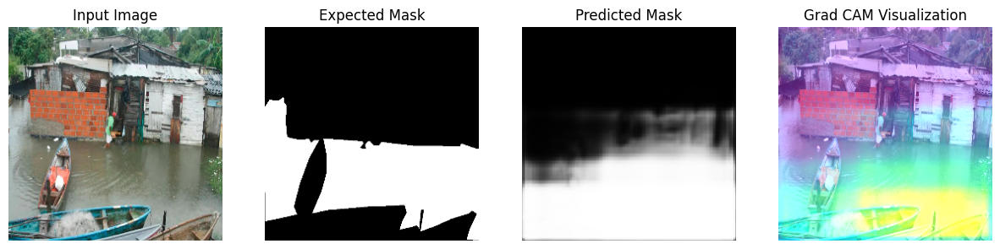

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 954ms/step - loss: 0.0306 - val_loss: 0.5923
Epoch 31/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 807ms/step - loss: 0.0295 - val_loss: 0.5876
Epoch 32/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 839ms/step - loss: 0.0292 - val_loss: 0.7262
Epoch 33/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 855ms/step - loss: 0.0316 - val_loss: 0.5357
Epoch 34/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 875ms/step - loss: 0.0372 - val_loss: 0.8699
Epoch 35/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 855ms/step - loss: 0.0310 - val_loss: 0.6418
Epoch 36/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 841ms/step - loss: 0.0327 - val_loss: 0.6314
Epoch 37/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 829ms/step - loss: 0.0299 - val_loss: 0.6232
Epoch 38/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 810ms/step - loss: 0.0344 - val_loss: 0.7846
Epoch 39/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 812ms/step - loss: 0.0374 - val_loss: 0.7042
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/stepep - loss: 0.02


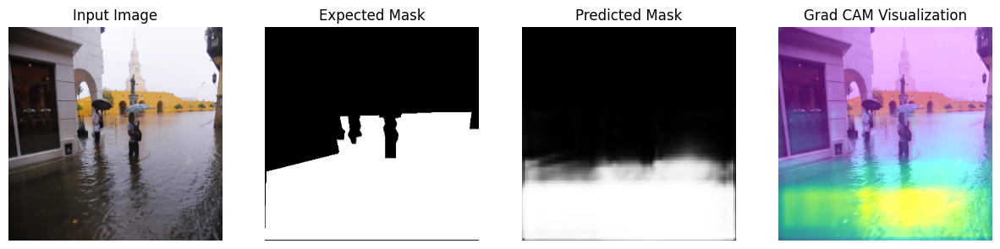

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 965ms/step - loss: 0.0265 - val_loss: 0.6687
Epoch 41/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 817ms/step - loss: 0.0263 - val_loss: 0.5113
Epoch 42/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 806ms/step - loss: 0.0329 - val_loss: 0.5234
Epoch 43/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 808ms/step - loss: 0.0336 - val_loss: 0.5128
Epoch 44/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 829ms/step - loss: 0.0278 - val_loss: 0.4983
Epoch 45/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 813ms/step - loss: 0.0300 - val_loss: 0.4807
Epoch 46/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 725ms/step - loss: 0.0231

16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 851ms/step - loss: 0.0233 - val_loss: 0.4305
Epoch 47/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 808ms/step - loss: 0.0237 - val_loss: 0.4577
Epoch 48/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 721ms/step - loss: 0.0263

16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 851ms/step - loss: 0.0262 - val_loss: 0.4121
Epoch 49/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 736ms/step - loss: 0.0240

16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 863ms/step - loss: 0.0240 - val_loss: 0.4111
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/stepep - loss: 0.02


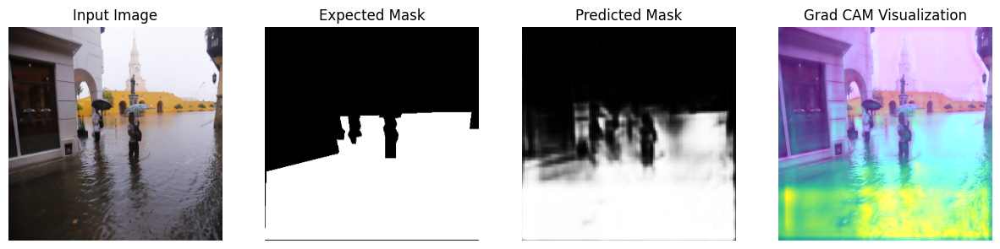

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 959ms/step - loss: 0.0231 - val_loss: 0.4276
Epoch 51/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 844ms/step - loss: 0.0277 - val_loss: 0.4286
Epoch 52/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 811ms/step - loss: 0.0217 - val_loss: 0.4397
Epoch 53/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 0s 791ms/step - loss: 0.0255

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 927ms/step - loss: 0.0254 - val_loss: 0.4085
Epoch 54/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 881ms/step - loss: 0.0217 - val_loss: 0.4953
Epoch 55/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 880ms/step - loss: 0.0208 - val_loss: 0.4553
Epoch 56/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 845ms/step - loss: 0.0250 - val_loss: 0.5216
Epoch 57/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 844ms/step - loss: 0.0234 - val_loss: 0.4571
Epoch 58/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 864ms/step - loss: 0.0211 - val_loss: 0.4188
Epoch 59/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 914ms/step - loss: 0.0193 - val_loss: 0.4241
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/stepep - loss: 0.02


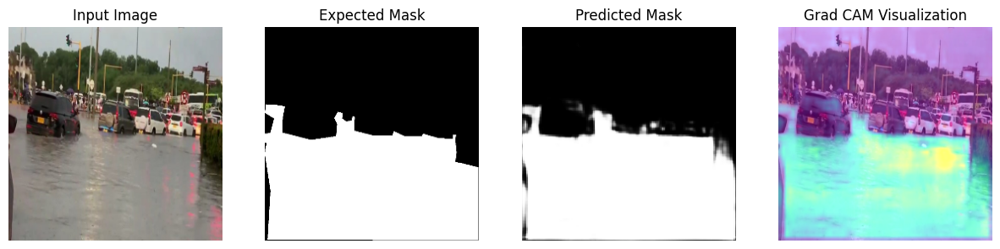

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - loss: 0.0207 - val_loss: 0.4562
Epoch 61/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 884ms/step - loss: 0.0256 - val_loss: 0.5006
Epoch 62/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 837ms/step - loss: 0.0207 - val_loss: 0.4868
Epoch 63/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 863ms/step - loss: 0.0222 - val_loss: 0.5266
Epoch 64/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 851ms/step - loss: 0.0212 - val_loss: 0.4988
Epoch 65/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 873ms/step - loss: 0.0217 - val_loss: 0.5293
Epoch 66/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 910ms/step - loss: 0.0193 - val_loss: 0.4931
Epoch 67/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 908ms/step - loss: 0.0216 - val_loss: 0.5037
Epoch 68/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 882ms/step - loss: 0.0197 - val_loss: 0.5205
Epoch 69/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 950ms/step - loss: 0.0171 - val_loss: 0.5486
Epoch 70/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 621ms/stepep - loss: 0.01


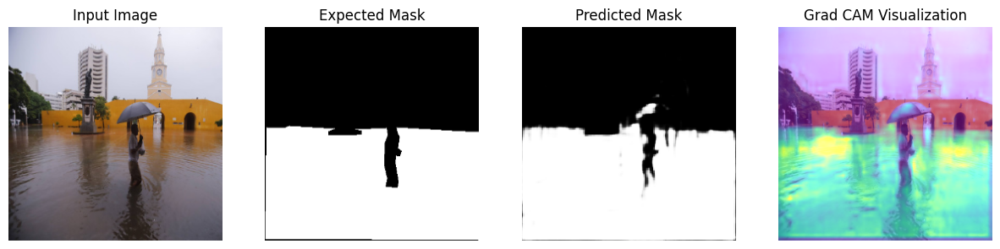

16/16 ━━━━━━━━━━━━━━━━━━━━ 17s 1s/step - loss: 0.0199 - val_loss: 0.5846
Epoch 71/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 896ms/step - loss: 0.0248 - val_loss: 0.6021
Epoch 72/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 904ms/step - loss: 0.0255 - val_loss: 0.6225
Epoch 73/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 882ms/step - loss: 0.0190 - val_loss: 0.6099
Epoch 74/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 865ms/step - loss: 0.0202 - val_loss: 0.5590
Epoch 75/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 843ms/step - loss: 0.0180 - val_loss: 0.5697
Epoch 76/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 867ms/step - loss: 0.0176 - val_loss: 0.6086
Epoch 77/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 869ms/step - loss: 0.0160 - val_loss: 0.6093
Epoch 78/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 869ms/step - loss: 0.0214 - val_loss: 0.5265
Epoch 79/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 833ms/step - loss: 0.0212 - val_loss: 0.6038
Epoch 80/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 620ms/stepep - loss: 0.02


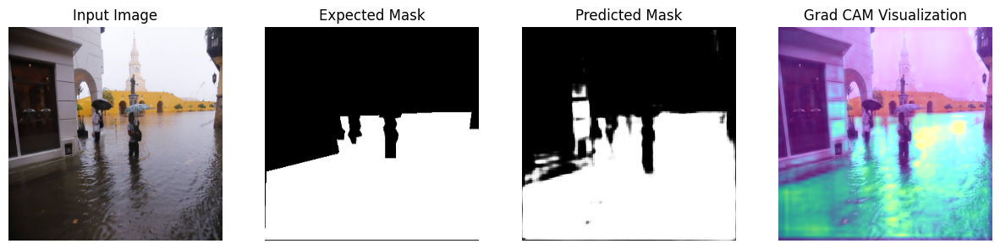

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 1s/step - loss: 0.0203 - val_loss: 0.6003
Epoch 81/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 847ms/step - loss: 0.0203 - val_loss: 0.5795
Epoch 82/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 822ms/step - loss: 0.0164 - val_loss: 0.5745
Epoch 83/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 831ms/step - loss: 0.0188 - val_loss: 0.5792
Epoch 84/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 815ms/step - loss: 0.0176 - val_loss: 0.5178
Epoch 85/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 847ms/step - loss: 0.0179 - val_loss: 0.5204
Epoch 86/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 830ms/step - loss: 0.0224 - val_loss: 0.5652
Epoch 87/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 865ms/step - loss: 0.0201 - val_loss: 0.5638
Epoch 88/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 834ms/step - loss: 0.0177 - val_loss: 0.5291
Epoch 89/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 831ms/step - loss: 0.0227 - val_loss: 0.5038
Epoch 90/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/stepep - loss: 0.01


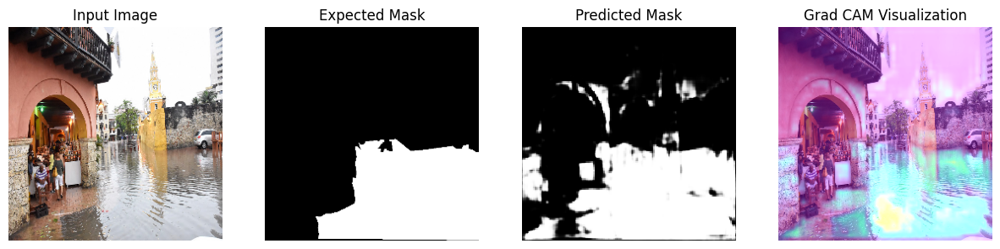

16/16 ━━━━━━━━━━━━━━━━━━━━ 16s 985ms/step - loss: 0.0194 - val_loss: 0.5175
Epoch 91/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 849ms/step - loss: 0.0238 - val_loss: 0.5522
Epoch 92/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 869ms/step - loss: 0.0180 - val_loss: 0.5348
Epoch 93/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 851ms/step - loss: 0.0193 - val_loss: 0.5656
Epoch 94/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 849ms/step - loss: 0.0166 - val_loss: 0.5476
Epoch 95/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 935ms/step - loss: 0.0182 - val_loss: 0.5425
Epoch 96/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 867ms/step - loss: 0.0164 - val_loss: 0.4845
Epoch 97/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 843ms/step - loss: 0.0141 - val_loss: 0.5141
Epoch 98/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 14s 886ms/step - loss: 0.0164 - val_loss: 0.5213
Epoch 99/100
16/16 ━━━━━━━━━━━━━━━━━━━━ 13s 835ms/step - loss: 0.0154 - val_loss: 0.5564
Epoch 100/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/stepep - loss: 0.01


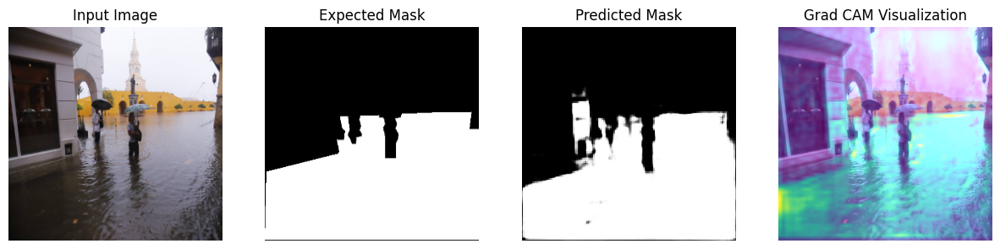

16/16 ━━━━━━━━━━━━━━━━━━━━ 15s 967ms/step - loss: 0.0168 - val_loss: 0.5794


In [18]:
# Compile
DeepLabV3.compile(
    loss='binary_crossentropy',
    optimizer="adam"
)

# Callbacks
callbacks = [
    ModelCheckpoint(MODEL_NAME+".h5", save_best_only=True),
    ShowProgress()
]

# Train
history = DeepLabV3.fit(
    train_images, train_masks,
    validation_data=(test_images, test_masks),
    epochs=100,
    callbacks=callbacks,
    batch_size=2,
)

### Learning curve

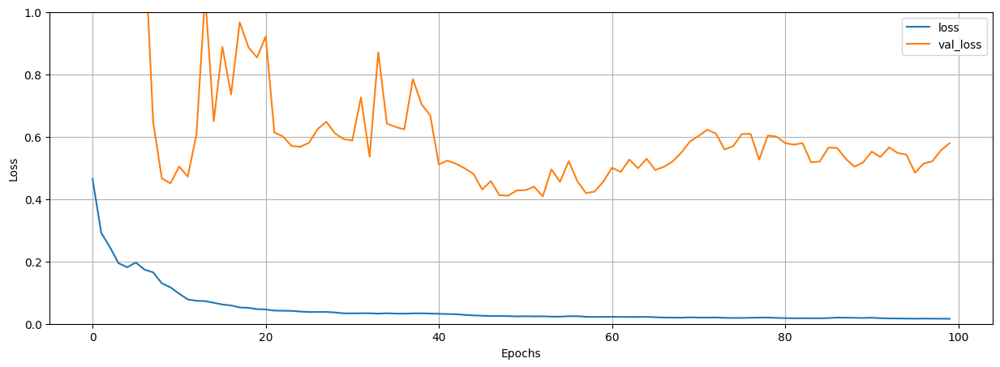

In [19]:
pd.DataFrame(history.history).plot(figsize=(15,5))
plt.ylim([0.0,1.0])
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.grid()
plt.show()

### Model predictions

Lets see how our trainded model predict:

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 633ms/step


c:\Users\usuario\Documents\DeepFlood\.venv\lib\site-packages\keras\src\models\functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['InputLayer']]
Received: inputs=['Tensor(shape=(1, 256, 256, 3))']
  warnings.warn(msg)


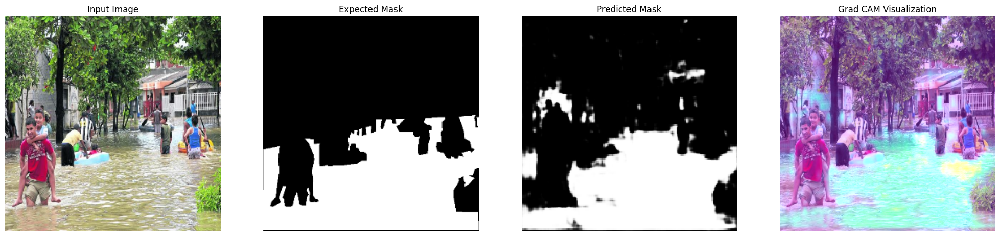

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step


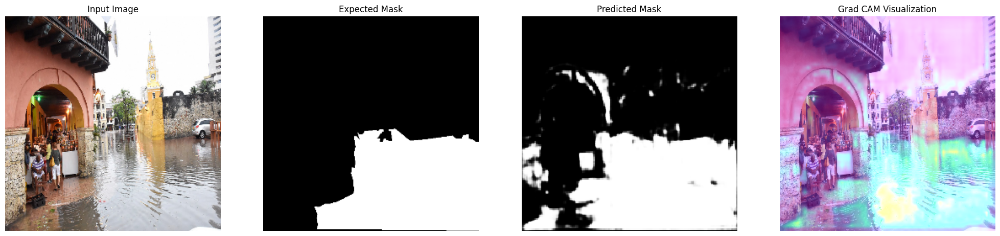

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step


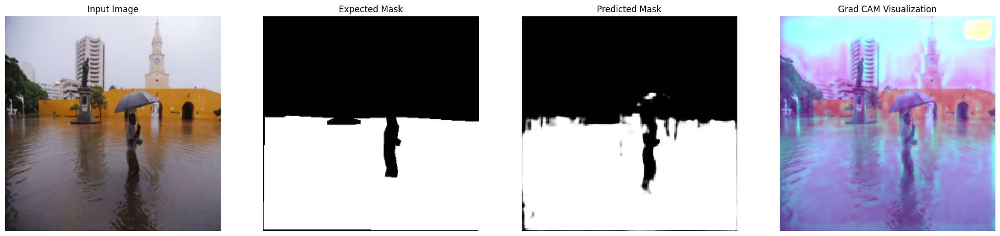

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step


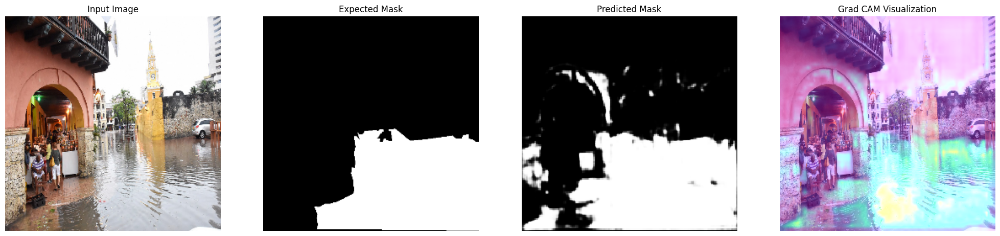

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 706ms/step


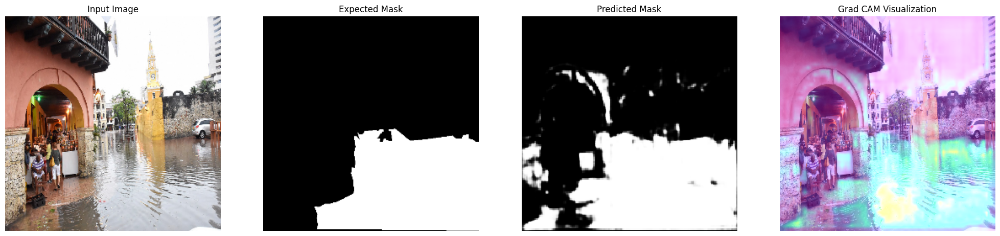

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step


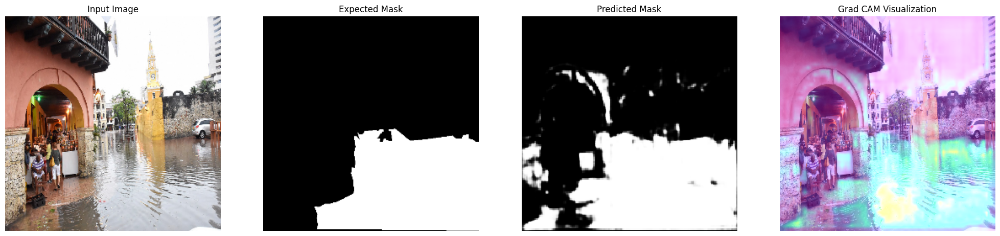

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step


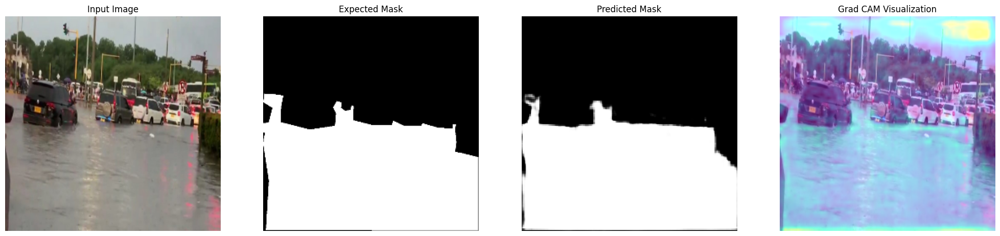

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step


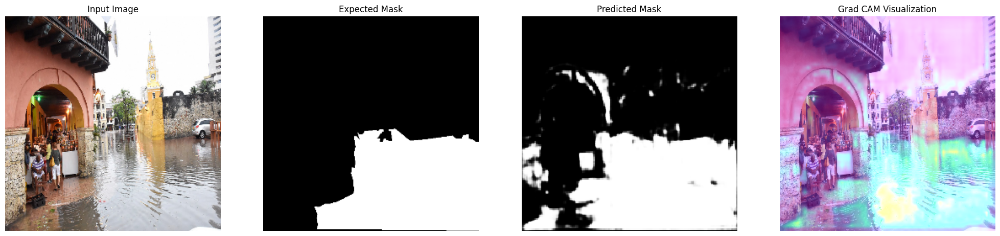

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step


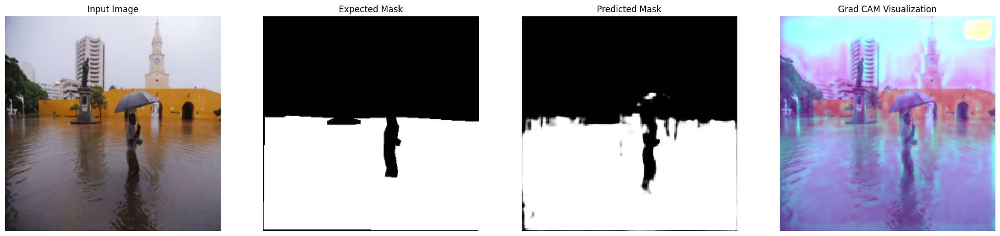

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 608ms/step


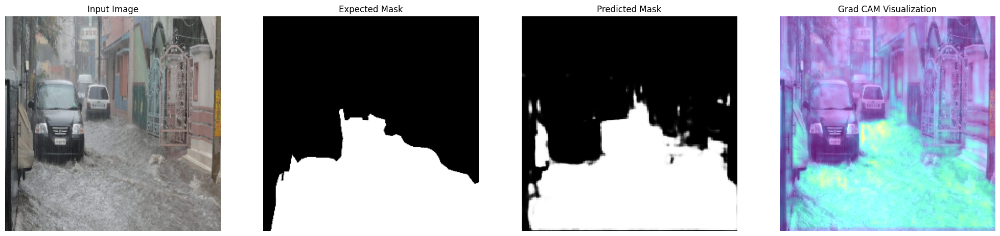

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step


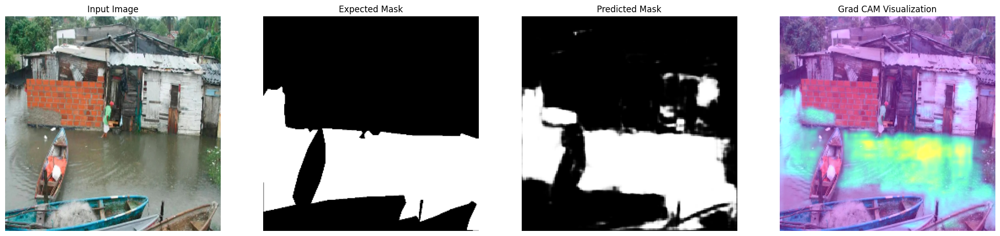

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 652ms/step


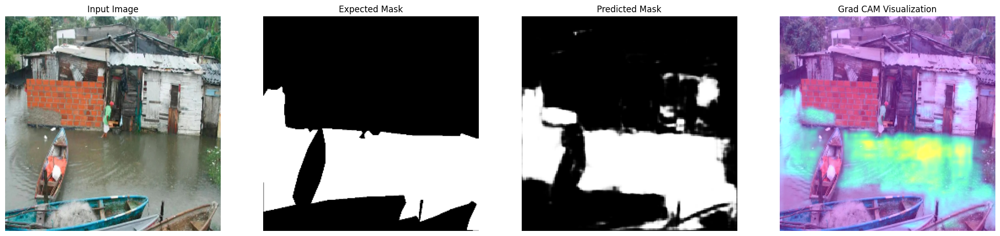

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 624ms/step


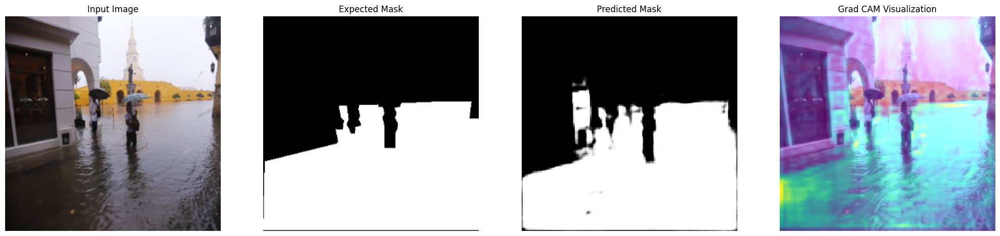

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 636ms/step


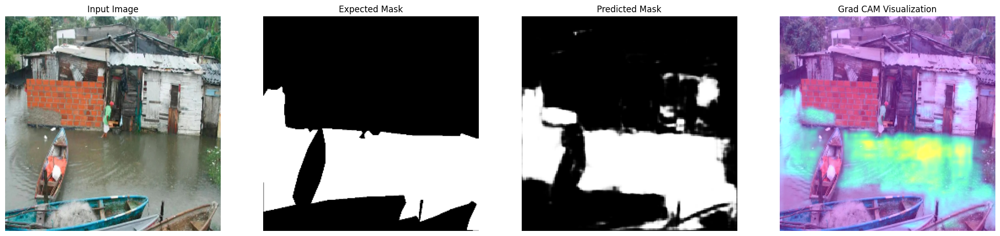

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 611ms/step


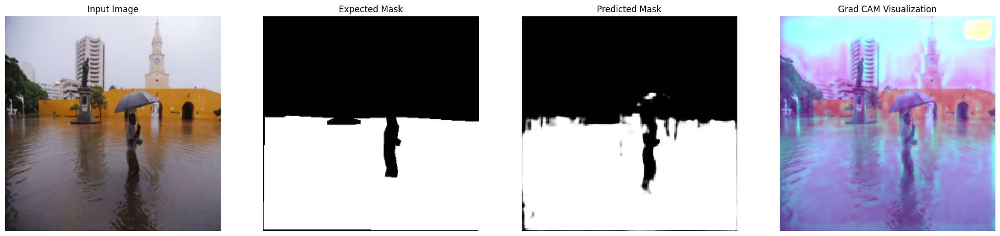

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 625ms/step


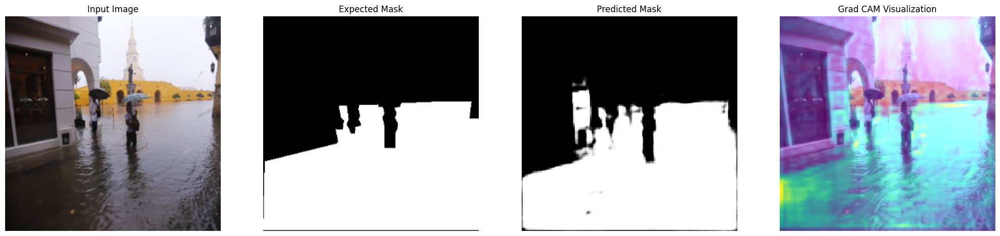

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 640ms/step


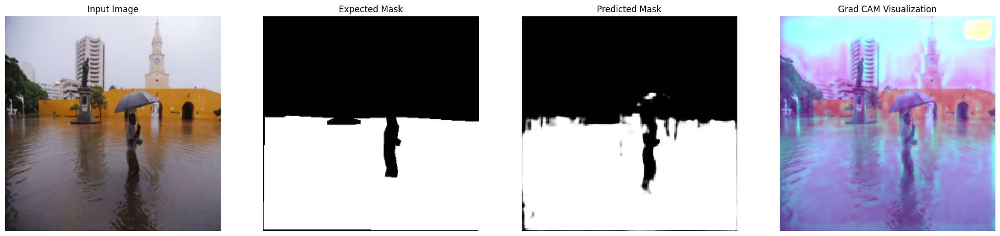

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 610ms/step


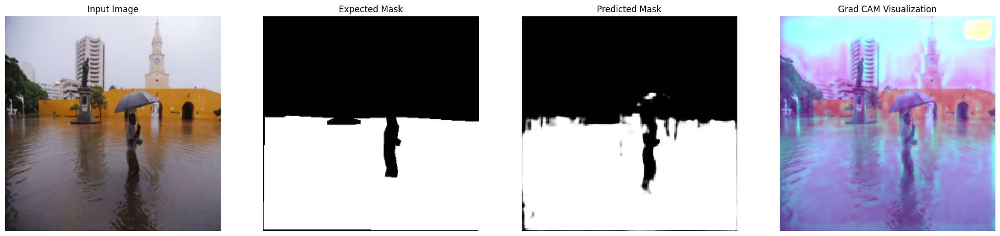

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 683ms/step


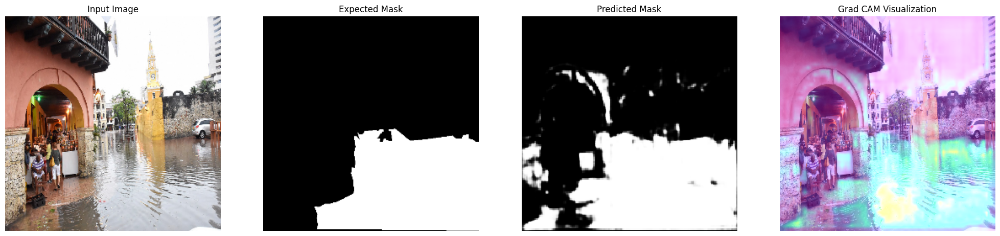

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 667ms/step


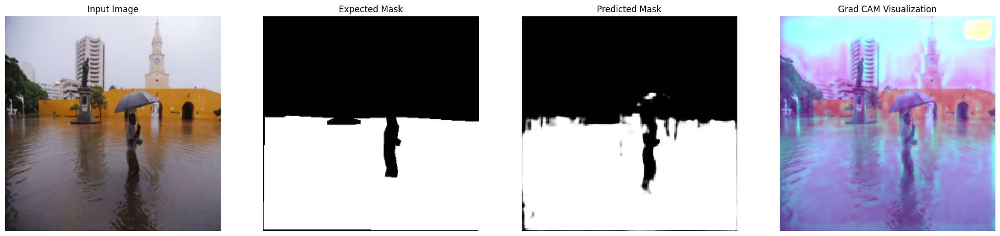

In [20]:
for i in range(20):
    show_model_preds(test_images, test_masks, model=DeepLabV3, SIZE=(25,8))